## Summary

Under certain cases, we need to do attention visualization to get a better understanding of the model. This notebook aims to provide runnable code snippets for this task.  


## Using `bertviz`


Check out example using Bert @ [Official Tutorial](https://colab.research.google.com/drive/1hXIQ77A4TYS4y3UthWF-Ci7V7vVUoxmQ?usp=sharing). 

In [1]:
import torch
from transformers import AutoModelForCausalLM, AutoTokenizer
from bertviz import head_view, model_view

# Load model
tokenizer = AutoTokenizer.from_pretrained("Qwen/Qwen2.5-3B-Instruct")
model = AutoModelForCausalLM.from_pretrained("Qwen/Qwen2.5-3B-Instruct", output_attentions=True, device_map="auto")

# Prepare input
text = "The quick brown fox jumps over the lazy dog"
inputs = tokenizer(text, return_tensors="pt").to(model.device)
outputs = model(**inputs)   # Forward pass to get attentions
attns = outputs.attentions  # tuple of (layers × batch × heads × seq × seq)
tokens = tokenizer.convert_ids_to_tokens(inputs["input_ids"][0])

/Users/chenkaihu/miniconda3/envs/llm-learning/lib/python3.11/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm
The following generation flags are not valid and may be ignored: ['output_attentions']. Set `TRANSFORMERS_VERBOSITY=info` for more details.
The following generation flags are not valid and may be ignored: ['output_attentions']. Set `TRANSFORMERS_VERBOSITY=info` for more details.
Loading checkpoint shards: 100%|██████████| 2/2 [00:05<00:00,  2.59s/it]


### Head View

In [2]:
head_view(attns, tokens)

<IPython.core.display.Javascript object>

### Model View

In [3]:
model_view(attns, tokens)

<IPython.core.display.Javascript object>

### Neuron view (on Bert)

In [ ]:
from bertviz.transformers_neuron_view import BertModel, BertTokenizer
from bertviz.neuron_view import show

sentence_a = "The cat sat on the mat"
sentence_b = "The cat lay on the rug"

model_type = 'bert'
model_version = 'bert-base-uncased'
model = BertModel.from_pretrained(model_version, output_attentions=True)
tokenizer = BertTokenizer.from_pretrained(model_version, do_lower_case=True)
show(model, model_type, tokenizer, sentence_a, sentence_b, layer=4, head=3)

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

## Manual Extraction

In [1]:
import torch
from transformers import AutoModelForCausalLM, AutoTokenizer

# Load model
model_name = "Qwen/Qwen2.5-3B-Instruct"
model = AutoModelForCausalLM.from_pretrained(model_name, output_attentions=True, device_map="auto")
tokenizer = AutoTokenizer.from_pretrained(model_name)

sample = [['Please solve the math problem.\nQuestion: What is the Product of 73 and 24? Please reason step by step.. I think the correct answer is: 1758\n', "<think>.\nTo find the product of 73 and 24, we can use the distributive property of multiplication over addition. This means we can break down the multiplication into smaller parts that are easier to calculate.\n\nFirst, let's express 24 as a sum of two numbers that are easier to multiply with 73. We can write 24 as 20 + 4. Now, we can use the distributive property to rewrite the multiplication as follows:.\n\n73 * 24 = 73 * (20 + 4).\n\nNext, we distribute the multiplication over the addition:.\n\n73 * (20 + 4) = (73 * 20) + (73 * 4).\n\nNow, we can calculate each term separately:.\n\n73 * 20 = 1460.\n73 * 4 = 292.\n\nFinally, we add the two results together: 1460 + 292. Therefore, my final answer is: "]]
instruct = sample[0][0]
cot = sample[0][1]
messages = [
    {"role": "system", "content": instruct},
    {"role": "user", "content": cot}
]
text = tokenizer.apply_chat_template(
    messages,
    tokenize=False,
    add_generation_prompt=True # token(s) that indicate the start of an assistant message will be appended to the formatted output
)

inputs = tokenizer(text, return_tensors="pt").to(model.device) # Input ids
gen_out = model.generate(
    **inputs,
    max_new_tokens=128,            # generate up to 128 new tokens
    output_attentions=True,       # tell the forward pass to keep attentions
    return_dict_in_generate=True  # return a GenerationOutput instead of just the tokens
)

seq      = gen_out.sequences                 # (batch, src + new) token ids
attns    = gen_out.attentions                # attns[generated_token][layer][batch_size, num_heads, generated_length, sequence_length]
# https://huggingface.co/docs/transformers/en/internal/generation_utils#transformers.generation.GenerateDecoderOnlyOutput.attentions

/Users/chenkaihu/miniconda3/envs/llm-learning/lib/python3.11/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm
The following generation flags are not valid and may be ignored: ['output_attentions']. Set `TRANSFORMERS_VERBOSITY=info` for more details.
The following generation flags are not valid and may be ignored: ['output_attentions']. Set `TRANSFORMERS_VERBOSITY=info` for more details.
Loading checkpoint shards: 100%|██████████| 2/2 [00:04<00:00,  2.21s/it]


In [11]:
inspect_token_index = 3 # 1-based index in the generated sequence
token_index = inputs["input_ids"].shape[1] + inspect_token_index - 1 # index in the full sequence (input + generated)

assert inspect_token_index < seq.shape[1]-inputs["input_ids"].shape[1], "Inspect token index out of bounds"
assert token_index < seq.shape[1], "Token index out of bounds"

tokens = tokenizer.convert_ids_to_tokens(seq[0], skip_special_tokens=False)[:token_index+1] # select correct subsequence
token_labels = [t.replace("Ġ", "") for t in tokens]  # remove BPE artifacts

# Extract attention from specified layer
layer_index = -2 
selected_layer = attns[inspect_token_index][layer_index] # (heads, seq, seq)
attn_from_i = selected_layer.squeeze()  # (heads, seq)
avg_attn_from_i = attn_from_i.mean(dim=0).cpu().detach().numpy()

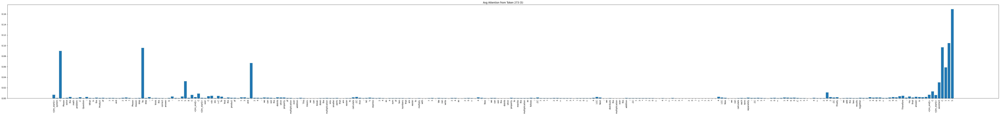

In [12]:
import matplotlib.pyplot as plt
# Plot
plt.figure(figsize=(max(12, len(token_labels) * 0.25), 8))
plt.bar(range(len(token_labels)), avg_attn_from_i)
plt.xticks(range(len(token_labels)), token_labels, rotation=90)
plt.title(f"Avg Attention from Token {token_index} ({token_labels[token_index]})")
plt.tight_layout()
plt.show()